## Lab - EDA Bivariate Analysis: Diving into Amazon UK Product Insights Part II

**Objective**: Delve into the dynamics of product pricing on Amazon UK to uncover insights that can inform business strategies and decision-making.

**Dataset**: This lab utilizes the [Amazon UK product dataset](https://www.kaggle.com/datasets/asaniczka/uk-optimal-product-price-prediction/)
which provides information on product categories, brands, prices, ratings, and more from from Amazon UK. You'll need to download it to start working with it.

---

In [42]:
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from scipy.stats import chi2_contingency
from scipy.stats.contingency import association
import statsmodels.api as sm #QQ plot

%matplotlib inline 
 #TE PERMITE HACER PLOTS EN MITAD DE UNA LINEA SIN QUE TE LO PUSE
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)


In [2]:
df = pd.read_csv('../amz_uk_price_prediction_dataset.csv')

---

### Part 1: Analyzing Best-Seller Trends Across Product Categories

**Objective**: Understand the relationship between product categories and their best-seller status.

1. **Crosstab Analysis**:
    - Create a crosstab between the product `category` and the `isBestSeller` status.
    
    - Are there categories where being a best-seller is more prevalent? 
    	
    	*Hint: one option is to calculate the proportion of best-sellers for each category and then sort the categories based on this proportion in descending order.*


2. **Statistical Tests**:
    - Conduct a Chi-square test to determine if the best-seller distribution is independent of the product category.
    - Compute Cramér's V to understand the strength of association between best-seller status and category.

3. **Visualizations**:
	- Visualize the relationship between product categories and the best-seller status using a stacked bar chart.

---

In [3]:
num = df.select_dtypes(include='number')
cat = df.select_dtypes(exclude='number')

In [4]:
crosstab = pd.crosstab(index=cat['category'], columns=cat['isBestSeller'])

true_best_sellers = crosstab[True].reset_index()
true_best_sellers = true_best_sellers.rename(columns={True: 'best_seller'})
true_best_sellers_sorted = true_best_sellers.sort_values(by='best_seller', ascending=False)
true_best_sellers_sorted.head()

,category,best_seller
109,Grocery,556
126,Health & Personal Care,552
9,Baby,341
262,Sports & Outdoors,330
229,Power & Hand Tools,306


Vemos que las categorias con mas best seller son las grocery, health & Personal care, baby y sports & outdoors. Estan son las categorias que agrupan mas best seller. Por tanto el estudio entre best seller y categorias se podria centrar en estas mencionadas

In [5]:
df['isBestSeller'].value_counts()

isBestSeller
False    2435671
True        7980
Name: count, dtype: int64

In [6]:
chi2_stats, chi2_pvalue, _, _ = chi2_contingency(crosstab)

In [7]:
chi2_contingency(crosstab)

Chi2ContingencyResult(statistic=36540.20270061387, pvalue=0.0, dof=295, expected_freq=array([[2.47190130e+02, 8.09870149e-01],
       [4.05371878e+03, 1.32812173e+01],
       [2.49183599e+02, 8.16401360e-01],
       [1.69145827e+03, 5.54173243e+00],
       [2.53170536e+02, 8.29463782e-01],
       [8.50214439e+03, 2.78556144e+01],
       [1.06650580e+02, 3.49419782e-01],
       [2.57157474e+02, 8.42526204e-01],
       [9.51781673e+03, 3.11832664e+01],
       [1.50008526e+04, 4.91473619e+01],
       [9.32544700e+03, 3.05530045e+01],
       [2.38219520e+02, 7.80479700e-01],
       [3.22941944e+03, 1.05805616e+01],
       [9.44704859e+03, 3.09514084e+01],
       [6.68808779e+03, 2.19122125e+01],
       [5.26275760e+02, 1.72423967e+00],
       [1.90296531e+04, 6.23469391e+01],
       [2.77191835e+03, 9.08164873e+00],
       [2.53170536e+02, 8.29463782e-01],
       [4.04674164e+02, 1.32583581e+00],
       [1.92489346e+04, 6.30653723e+01],
       [3.10482764e+03, 1.01723609e+01],
       [2.04

In [8]:
association(crosstab, method='cramer')

0.1222829439760564

Segun el test de Cramer, al ser 0.12, no hay una asociacion entre ambas variables

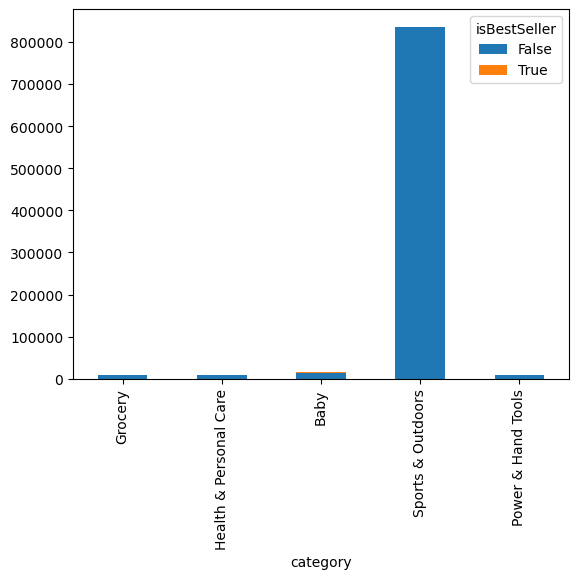

In [9]:
crosstab.sort_values(by=True,ascending=False).head().plot(kind='bar', stacked=True)


plt.show()

### Part 2: Exploring Product Prices and Ratings Across Categories and Brands

**Objective**: Investigate how different product categories influence product prices.

2. **Bar Charts**:
    - Create a bar chart comparing the average price of products for the top 10 product categories (based on count).
    - Which product category commands the highest average price? Don't filter here by top categories.

3. **Box Plots**:
    - Visualize the distribution of product `ratings` based on their `category` using side-by-side box plots. Filter out the top 10 categories based on count for better visualization.
    - Which category tends to receive the highest median rating from customers? Don't filter here by top categories.

---

0. **Preliminary Step: Remove outliers in product prices.**

	For this purpose, we can use the IQR (Interquartile Range) method. Products priced below the first quartile minus 1.5 times the IQR or above the third quartile plus 1.5 times the IQR will be considered outliers and removed from the dataset. The next steps will be done with the dataframe without outliers.
	
	*Hint: you can check the last Check For Understanding at the end of the lesson EDA Bivariate Analysis for a hint on how to do this.*


In [10]:
def tukeys_test_outliers(data):
    Q1 = data.quantile(0.25)
    Q3 = data.quantile(0.75)
    IQR = Q3 - Q1
    
    # Define bounds for the outliers
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    
    # Identify the outliers
    outliers = data[(data < lower_bound) | (data > upper_bound)]
    
    return outliers

In [11]:
data_series = df['price']  # replace 'ColumnName' with your specific column
outliers = tukeys_test_outliers(data_series)
print(outliers)

10            139.00
19            164.99
25            149.99
28            289.00
31            199.99
33            128.00
34            959.99
35            149.00
36            169.00
37            368.99
40            184.99
48            129.99
49            628.50
50            114.39
51            159.99
53            103.99
56            443.77
63            149.00
65            185.79
67            150.98
69            230.95
71            149.00
73            145.00
74            169.00
76            209.99
78            184.99
80            113.00
81            359.00
82            164.97
83            199.95
84            110.49
85            229.00
87            164.99
89            797.92
90            149.99
91            230.00
93            309.99
95            489.99
96            134.99
97            309.00
98            140.00
100           139.99
104           103.99
108           199.00
110           169.00
111           118.00
112           149.00
114          

In [12]:
outliers.index

Index([     10,      19,      25,      28,      31,      33,      34,      35,
            36,      37,
       ...
       2443590, 2443591, 2443603, 2443613, 2443614, 2443619, 2443627, 2443638,
       2443641, 2443643],
      dtype='int64', length=327688)

In [13]:
df2 = df.copy()

In [14]:
df2 = df.drop(index=outliers.index)


1. **Violin Plots**:
    - Use a violin plot to visualize the distribution of `price` across different product `categories`. Filter out the top 20 categories based on count for better visualization.
  

In [15]:
df3 = df2.copy()

In [16]:
price_cat = df3['category'].value_counts().head(20).index
price_cat
top_cat = df3[df3['category'].isin(price_cat)]
#price_cat = price_cat.sort_values(ascending=False).reset_index().head(20) #.iloc[1:21]


C:\Users\Darkos\AppData\Local\Temp\ipykernel_5220\990058150.py:1: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(data=top_cat, x="category", y="price", palette="coolwarm")


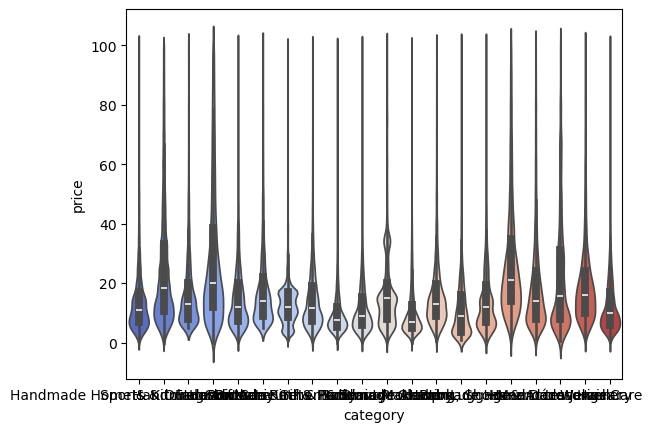

In [17]:
sns.violinplot(data=top_cat, x="category", y="price", palette="coolwarm")
plt.show()

  - Which product category tends to have the highest median price? Don't filter here by top categories.

In [18]:
highest_median_price = df3.groupby('category')['price'].median()

2. **Bar Charts**:
    - Create a bar chart comparing the average price of products for the top 10 product categories (based on count).
    - Which product category commands the highest average price? Don't filter here by top categories.


In [19]:
top_10 = df3['category'].value_counts().head(10).index
top_10_result = df3[df3['category'].isin(top_10)]


C:\Users\Darkos\AppData\Local\Temp\ipykernel_5220\2504179718.py:1: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=top_10_result, x="category", y="price", palette="coolwarm")


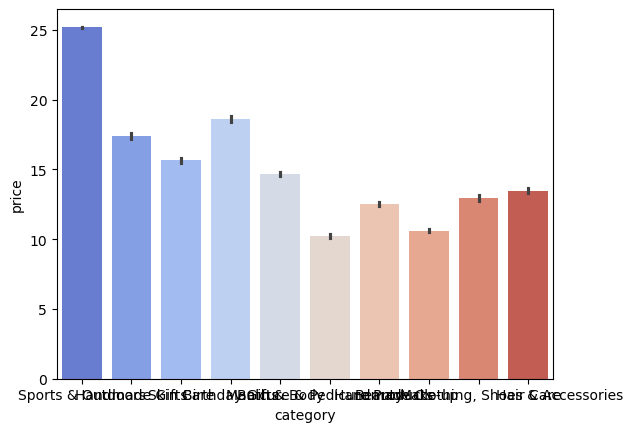

In [22]:
sns.barplot(data=top_10_result, x="category", y="price", palette="coolwarm")

plt.show()

3. **Box Plots**:
    - Visualize the distribution of product `ratings` based on their `category` using side-by-side box plots. Filter out the top 10 categories based on count for better visualization.
 

In [24]:
top_10_ratings = df3['category'].value_counts().head(10).index
top_10_ratings_result = df3[df3['category'].isin(top_10_ratings)]

C:\Users\Darkos\AppData\Local\Temp\ipykernel_5220\1629315078.py:1: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=top_10_ratings_result, x="category", y="stars", palette="coolwarm")


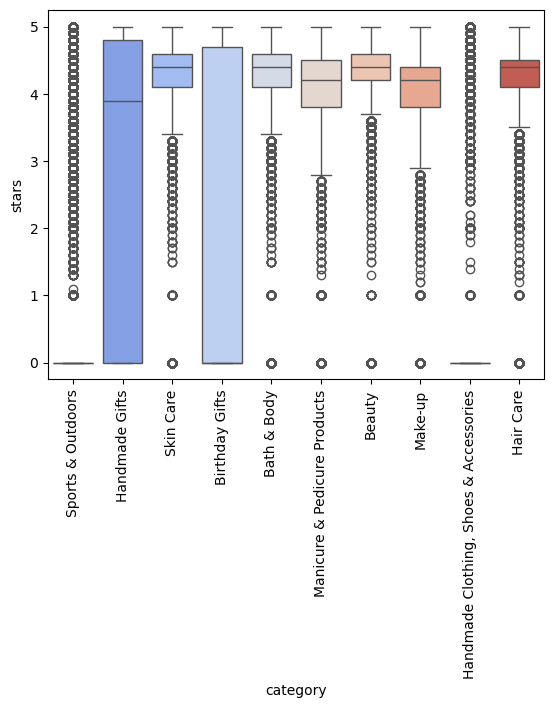

In [27]:
sns.boxplot(data=top_10_ratings_result, x="category", y="stars", palette="coolwarm")
plt.xticks(rotation=90)
plt.show()

   - Which category tends to receive the highest median rating from customers? Don't filter here by top categories.

In [30]:
highest_median_rating = df3.groupby('category')['stars'].median()
highest_median_rating.sort_values(ascending=False)

category
Computer Memory                                     4.70
Building & Construction Toys                        4.60
Office Paper Products                               4.60
Luxury Food & Drink                                 4.60
Kids' Play Figures                                  4.60
Hobbies                                             4.60
Beer, Wine & Spirits                                4.60
Laptop Accessories                                  4.60
Cables & Accessories                                4.50
CPUs                                                4.50
Soft Toys                                           4.50
Health & Personal Care                              4.50
Film Cameras                                        4.50
Boxes & Organisers                                  4.50
Children's Bedding                                  4.50
School & Educational Supplies                       4.50
Computer & Server Racks                             4.50
Pens, Pencils & Writin

### Part 3: Investigating the Interplay Between Product Prices and Ratings

**Objective**: Analyze how product ratings (`stars`) correlate with product prices.

1. **Correlation Coefficients**:
    - Calculate the correlation coefficient between `price` and `stars`.
    - Is there a significant correlation between product price and its rating?


In [33]:
df3['stars'].corr(df3['price']) # PEARSON

-0.07767299878181323

In [34]:
df['stars'].corr(df['price'], method='spearman')

-0.13316425462433912

Ambos valores sugieren que prácticamente no hay relación entre las dos variables. Aunque hay una ligera tendencia negativa, es tan cercana a cero que se considera insignificante y podría ser simplemente ruido.

2. **Visualizations**:
    - Use a scatter plot to visualize the relationship between product rating and price. What patterns can you observe?
    - Use a correlation heatmap to visualize correlations between all numerical variables.
    - Examine if product prices typically follow a normal distribution using a QQ plot. 


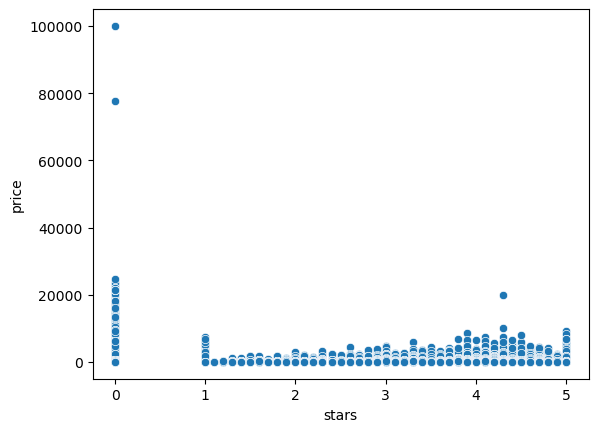

In [35]:
sns.scatterplot(data=df, x='stars', y='price')
plt.show()

In [37]:
correlation_matrix = num.corr()

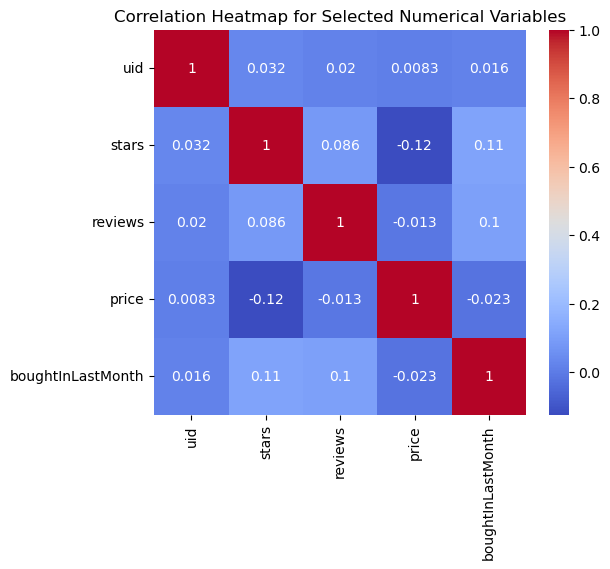

In [41]:
# Setting up the matplotlib figure with an appropriate size
plt.figure(figsize=(6,5))

# Drawing the heatmap for the numerical columns
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm")

plt.title("Correlation Heatmap for Selected Numerical Variables")
plt.show()

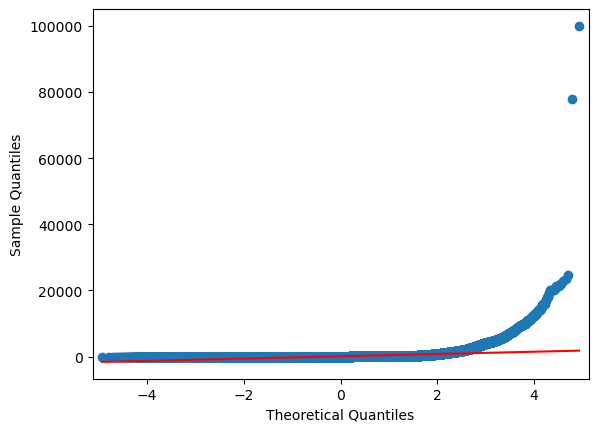

<Figure size 1000x500 with 0 Axes>

In [47]:
sm.qqplot(df['price'], line='s')
plt.figure(figsize=(10,5))
plt.show()

From the QQ plot of `Price`:
- **Lower Tail**: In the lower tail (left side of the plot), the data points lie below the red line. This indicates that the distribution of `Price` has heavier tails on the lower side than the normal distribution.
- **Upper Tail**: In the upper tail (right side of the plot), the data points deviate significantly from the red line, suggesting a long tail or skewness to the right. This indicates that there are more extreme high values in `SalePrice` than would be expected in a normal distribution.
- **Central Portion**: The central portion of the data points doesn't align perfectly with the line, suggesting possible deviations from normality in the main body of the distribution as well.


In [49]:
outliers

2008013    100000.00
1987238     77752.00
1905315     24674.59
1408966     23482.73
319555      22933.42
1490286     21999.00
1490285     21999.00
1907271     21464.82
1907272     21464.82
1907273     21464.82
1430208     20489.75
1758235     20216.00
1430241     20015.45
1490272     19999.00
1490280     19999.00
1490231     19999.00
1490269     19999.00
367848      19990.00
589336      19290.93
1408974     19211.51
322759      18244.80
2392759     18169.83
2393389     18144.00
2392228     17837.54
2393205     17611.51
1416210     17139.30
1490252     16999.00
1757094     16367.43
2393494     16113.99
864567      16000.00
804934      16000.00
1490257     15999.00
1430217     15991.55
1430381     15952.79
1429899     15767.15
1758932     15736.30
2243389     15654.93
2392704     15636.29
1430243     14852.21
2242020     14611.22
1757096     14548.73
1430095     14416.67
1430400     14371.79
1430201     14265.71
1490253     13999.00
1490258     13999.00
1490238     13999.00
1490236     1